In [1]:
# !pip install pyarrow gdown -qq

## Download Data

In [2]:
# !gdown --fuzzy 'https://drive.google.com/file/d/1mqtONldpayaQ97SH1p_UfdoH6nywVfYt/view?usp=sharing'

In [3]:
import pandas as pd

df = pd.read_parquet('detection_results_validation.parquet')
df

,filename,classid,score,x1,y1,x2,y2
0,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.971191,20,99,336,604
1,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.963867,342,0,664,609
2,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.945312,698,166,1008,864
3,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.931641,496,0,587,86
4,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.916992,50,91,123,185
...,...,...,...,...,...,...,...
142674,/workspace/yolo_v8_training/oiv7_full/validati...,3,0.865234,317,273,347,319
142675,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.922852,209,467,280,578
142676,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.859863,213,464,253,501
142677,/workspace/yolo_v8_training/oiv7_full/validati...,2,0.640625,265,493,284,510


In [4]:
# Create the mapping dictionary
label_map = {0: 'person', 1: 'head', 2: 'hand', 3: 'face'}

df['label'] = df['classid'].map(label_map)

In [5]:
df

,filename,classid,score,x1,y1,x2,y2,label
0,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.971191,20,99,336,604,person
1,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.963867,342,0,664,609,person
2,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.945312,698,166,1008,864,person
3,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.931641,496,0,587,86,head
4,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.916992,50,91,123,185,head
...,...,...,...,...,...,...,...,...
142674,/workspace/yolo_v8_training/oiv7_full/validati...,3,0.865234,317,273,347,319,face
142675,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.922852,209,467,280,578,person
142676,/workspace/yolo_v8_training/oiv7_full/validati...,1,0.859863,213,464,253,501,head
142677,/workspace/yolo_v8_training/oiv7_full/validati...,2,0.640625,265,493,284,510,hand


In [6]:
# Get rows with person label
df = df[df['label'] == 'person'] 
df

,filename,classid,score,x1,y1,x2,y2,label
0,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.971191,20,99,336,604,person
1,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.963867,342,0,664,609,person
2,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.945312,698,166,1008,864,person
13,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.889648,740,0,956,261,person
14,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.941406,213,0,1020,666,person
...,...,...,...,...,...,...,...,...
142662,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.958496,13,9,728,1024,person
142667,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.889160,371,445,421,593,person
142669,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.789551,268,124,300,148,person
142672,/workspace/yolo_v8_training/oiv7_full/validati...,0,0.941895,242,252,374,576,person


In [7]:
df = df.head(1000) # remove this!

## Convert Data to VOC format

In [8]:
import os
import xml.etree.ElementTree as ET
from PIL import Image
from xml.dom import minidom


def create_object_element(object_data):
    obj_elem = ET.Element('object')
    ET.SubElement(obj_elem, 'name').text = str(object_data['label'])
    ET.SubElement(obj_elem, 'pose').text = 'Unspecified'
    ET.SubElement(obj_elem, 'truncated').text = '0'
    ET.SubElement(obj_elem, 'difficult').text = '0'
    
    bndbox = ET.SubElement(obj_elem, 'bndbox')
    ET.SubElement(bndbox, 'xmin').text = str(object_data['x1'])
    ET.SubElement(bndbox, 'ymin').text = str(object_data['y1'])
    ET.SubElement(bndbox, 'xmax').text = str(object_data['x2'])
    ET.SubElement(bndbox, 'ymax').text = str(object_data['y2'])
    
    return obj_elem

def create_voc_xml(filename, objects, output_dir):
    annotation = ET.Element('annotation')
    ET.SubElement(annotation, 'filename').text = os.path.basename(filename)
    
    image = Image.open(filename)
    width, height = image.size
    
    size = ET.SubElement(annotation, 'size')
    ET.SubElement(size, 'width').text = str(width)
    ET.SubElement(size, 'height').text = str(height)
    ET.SubElement(size, 'depth').text = str(len(image.getbands()))
    
    for object_data in objects:
        annotation.append(create_object_element(object_data))
    
    # Create a new XML document
    xml_str = ET.tostring(annotation, encoding='utf-8')
    dom = minidom.parseString(xml_str)
    
    # Pretty-print the XML with indentation
    pretty_xml = dom.toprettyxml(indent='    ')
    
    output_file = os.path.join(output_dir, f"{os.path.splitext(os.path.basename(filename))[0]}.xml")
    with open(output_file, 'w', encoding='utf-8') as f:
        f.write(pretty_xml)

In [9]:
import os
from tqdm.auto import tqdm

output_directory = 'pascal_voc_annotations'
os.makedirs(output_directory, exist_ok=True)

grouped_df = df.groupby('filename').apply(lambda x: x.to_dict('records')).reset_index(name='objects')


for row in tqdm(grouped_df.itertuples(index=False), total=len(grouped_df), desc='Generating annotations', unit=' imgs'):
    filename = row.filename
    objects = row.objects
    create_voc_xml(filename, objects, output_directory)

<ipython-input-9-e4a49b0192d3>:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  grouped_df = df.groupby('filename').apply(lambda x: x.to_dict('records')).reset_index(name='objects')


Generating annotations:   0%|          | 0/242 [00:00<?, ? imgs/s]

## Plot XML to verify conversion is correct

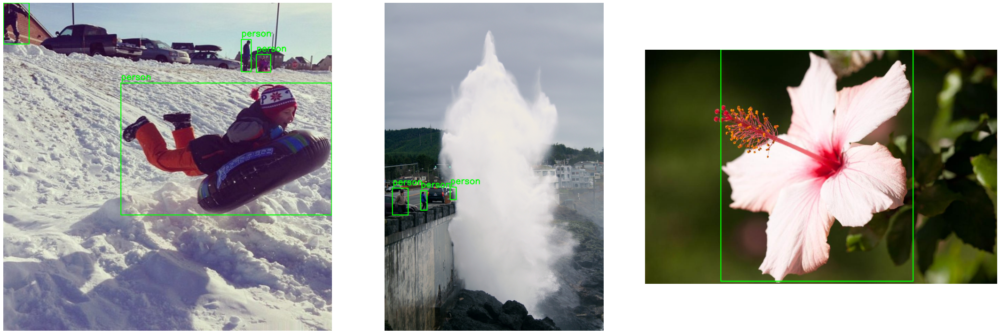

In [10]:
import os
import random
import cv2
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET

def plot_random_image_with_bounding_boxes(xml_folder, image_folder, num_images):
    # Get the list of XML files in the folder
    xml_files = [file for file in os.listdir(xml_folder) if file.endswith('.xml')]
    
    # Randomly select num_images XML files
    random_xml_files = random.sample(xml_files, num_images)
    
    # Create a figure with subplots for each image
    fig, axes = plt.subplots(1, num_images, figsize=(10 * num_images, 10))
    
    # Iterate over the randomly selected XML files
    for i, xml_file in enumerate(random_xml_files):
        xml_path = os.path.join(xml_folder, xml_file)
        
        # Parse the XML file
        tree = ET.parse(xml_path)
        root = tree.getroot()
        
        # Get the image filename from the XML
        image_filename = root.find('filename').text
        image_path = os.path.join(image_folder, image_filename)
        
        # Read the image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Extract the bounding box information
        for obj in root.findall('object'):
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            class_id = obj.find('name').text
            
            # Draw the bounding box on the image
            cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            
            # Put the class ID text above the bounding box
            cv2.putText(image, class_id, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)
        
        # Plot the image with bounding boxes and class IDs in the corresponding subplot
        axes[i].imshow(image)
        axes[i].axis('off')
    
    # Adjust the spacing between subplots
    plt.tight_layout()
    
    # Display the plots
    plt.show()


image_folder = '/workspace/yolo_v8_training/oiv7_full/validation/'
xml_folder = 'pascal_voc_annotations/'

plot_random_image_with_bounding_boxes(xml_folder, image_folder, num_images=3)

## Load Into IceVision

In [11]:
from icevision.all import *

parser = parsers.VOCBBoxParser(annotations_dir='pascal_voc_annotations/', 
                               images_dir='/workspace/yolo_v8_training/oiv7_full/validation/')

INFO     - The mmdet config folder already exists. No need to downloaded it. Path : /root/.icevision/mmdetection_configs/mmdetection_configs-2.20.1/configs | icevision.models.mmdet.download_configs:download_mmdet_configs:17


In [12]:
# Parse annotations to create records
train_records, valid_records = parser.parse() # Defaults to 80:20 split
parser.class_map

  0%|          | 0/242 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/242 [00:00<?, ?it/s]

<ClassMap: {'background': 0, 'person': 1}>

In [13]:
image_size = 640
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=720), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

In [14]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

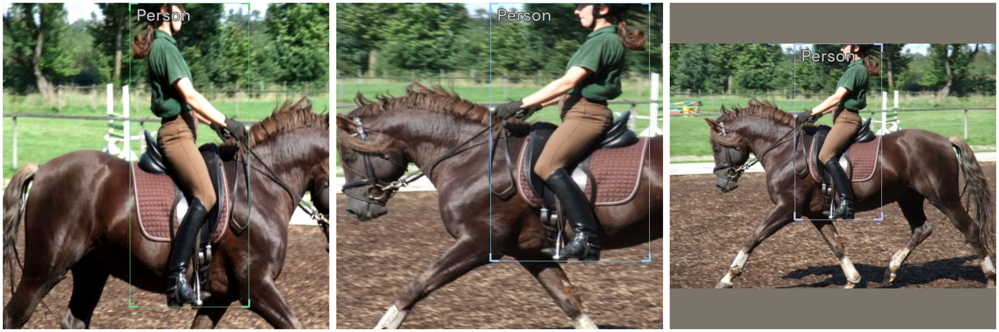

In [15]:
%matplotlib inline
# Show an element of the train_ds with augmentation transformations applied
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

In [16]:
extra_args = {}
model_type = models.mmdet.vfnet
backbone = model_type.backbones.resnet50_fpn_mstrain_2x
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), **extra_args) 


/root/miniforge-pypy3/envs/icevision/lib/python3.9/site-packages/mmdet/core/anchor/builder.py:16: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(
2024-03-12 07:22:37,895 - mmcv - INFO - initialize ResNet with init_cfg {'type': 'Pretrained', 'checkpoint': 'torchvision://resnet50'}
2024-03-12 07:22:37,896 - mmcv - INFO - load model from: torchvision://resnet50
2024-03-12 07:22:37,897 - mmcv - INFO - load checkpoint from torchvision path: torchvision://resnet50
2024-03-12 07:22:37,996 - mmcv - WARNING - The model and loaded state dict do not match exactly

unexpected key in source state_dict: fc.weight, fc.bias

2024-03-12 07:22:38,005 - mmcv - INFO - initialize FPN with init_cfg {'type': 'Xavier', 'layer': 'Conv2d', 'distribution': 'uniform'}
2024-03-12 07:22:38,066 - mmcv - INFO - initialize VFNetHead with init_cfg {'type': 'Normal', 'layer': 'Conv2d', 'std': 0.01, 'override': {'type': 'Normal', 'name': 'vfnet_cls'

load checkpoint from local path: checkpoints/vfnet/vfnet_r50_fpn_mstrain_2x_coco_20201027-7cc75bd2.pth
The model and loaded state dict do not match exactly

size mismatch for bbox_head.vfnet_cls.weight: copying a param with shape torch.Size([80, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([1, 256, 3, 3]).
size mismatch for bbox_head.vfnet_cls.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([1]).


In [17]:
train_dl = model_type.train_dl(train_ds, batch_size=16, num_workers=4, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=16, num_workers=4, shuffle=False)

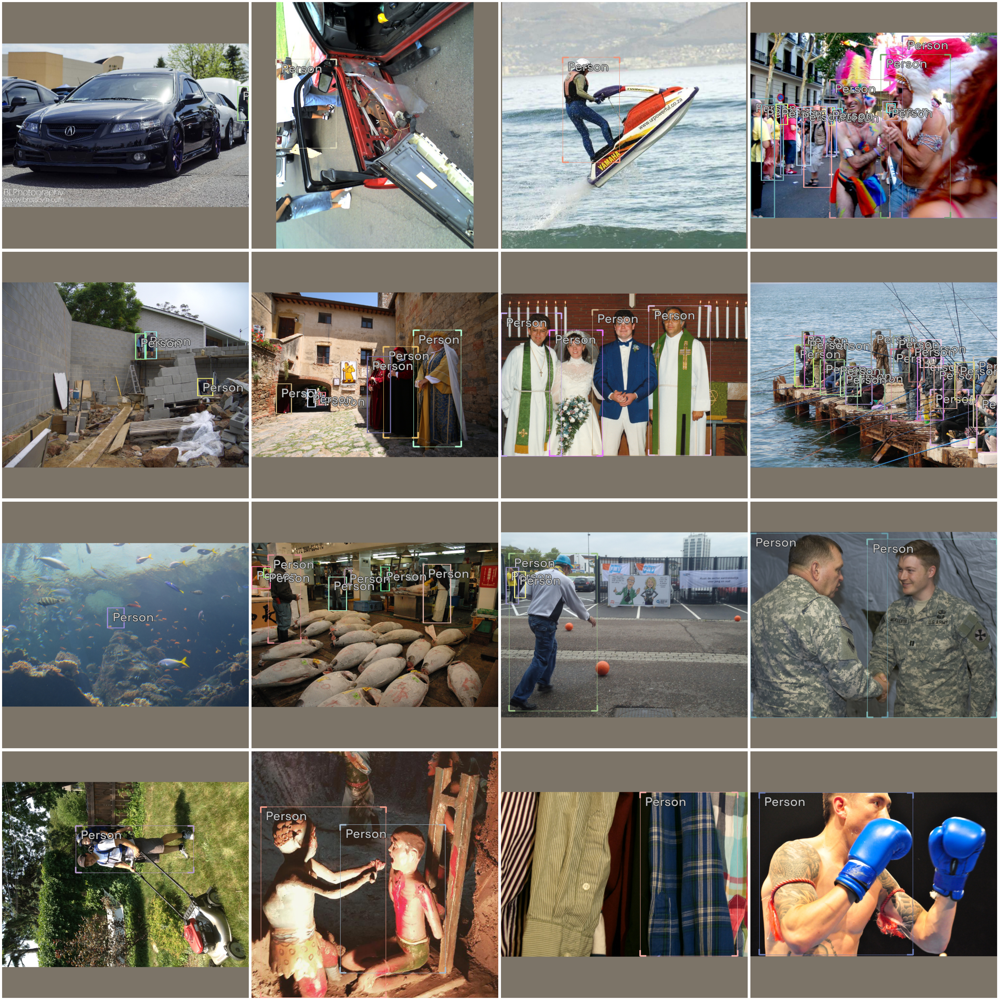

In [18]:
model_type.show_batch(first(valid_dl), ncols=4)

In [19]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, metrics=metrics)

/root/miniforge-pypy3/envs/icevision/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1639180487213/work/aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/root/miniforge-pypy3/envs/icevision/lib/python3.9/site-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/root/miniforge-pypy3/envs/icevision/lib/python3.9/site-packages/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  warnings.warn(


SuggestedLRs(valley=0.001737800776027143)

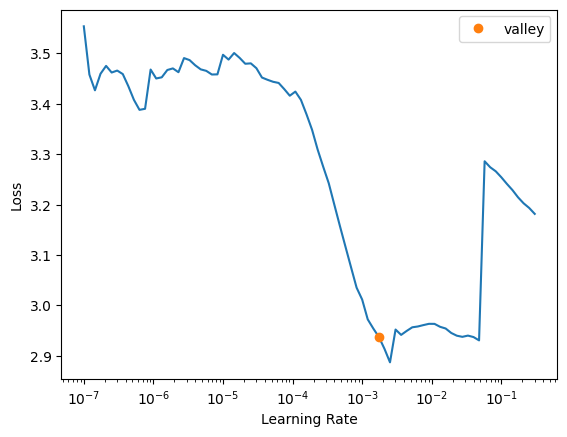

In [20]:
learn.lr_find()

In [21]:
learn.fine_tune(20, 0.001, freeze_epochs=5)

epoch,train_loss,valid_loss,COCOMetric,time
0,3.204165,2.616919,0.170367,00:12
1,2.544317,1.501516,0.407519,00:12
2,2.164036,1.606954,0.429736,00:13
3,1.989144,1.530336,0.403288,00:13
4,1.891172,1.802229,0.417713,00:13


epoch,train_loss,valid_loss,COCOMetric,time
0,1.578684,1.384941,0.498475,00:14
1,1.568066,1.375882,0.494641,00:13
2,1.530037,1.383095,0.482372,00:13
3,1.514731,1.355798,0.497183,00:13
4,1.492317,1.575779,0.390220,00:13
5,1.515715,1.680453,0.426375,00:13
6,1.557052,1.602471,0.359449,00:13
7,1.553166,1.551473,0.436039,00:12
8,1.541665,1.605358,0.421049,00:12
9,1.546598,1.465104,0.447029,00:13


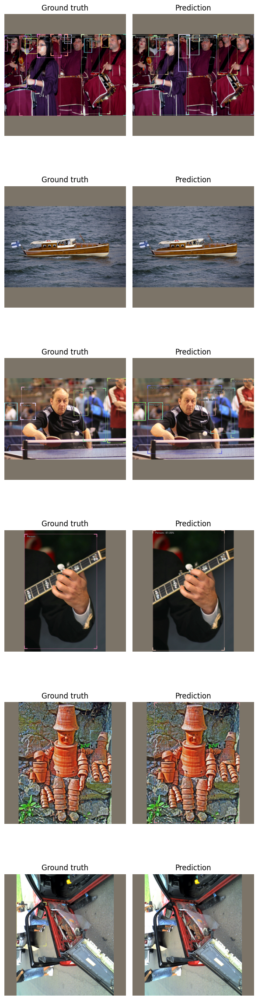

In [22]:
model_type.show_results(model, valid_ds, detection_threshold=.5)

INFO     - Losses returned by model: ['loss_cls', 'loss_bbox'] | icevision.models.interpretation:plot_top_losses:219


  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

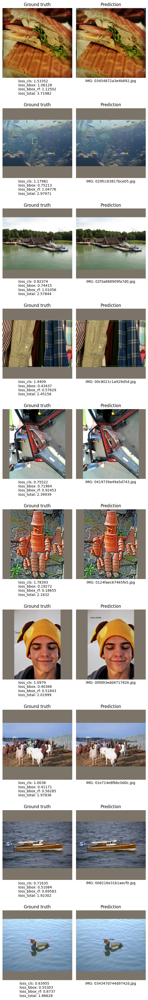

In [23]:
sorted_samples, sorted_preds, losses_stats = model_type.interp.plot_top_losses(model, valid_ds, sort_by="loss_total", n_samples=10)

In [24]:
from icevision.models.checkpoint import *
save_icevision_checkpoint(model,
                        model_name='mmdet.vfnet', 
                        backbone_name='resnet50_fpn_mstrain_2x',
                        img_size=640,
                        classes=parser.class_map.get_classes(),
                        filename='./models/model_checkpoint.pth',
                        meta={'icevision_version': '0.12.0'})